In [1]:
%cd ..

/home/zengyun1/gnn/TMP_NN


/home/zengyun1/App/miniconda3/envs/gnn/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [10]:
import numpy as np
import torch


In [3]:
import pickle
with open('Dataset/Myers-Saito_cyclization.pkl', 'rb') as file:
    data_list = pickle.load(file)

In [4]:
from torch.utils.data import TensorDataset, DataLoader,random_split

def get_datalist(data_list):
    data_size = len(data_list)
    
    x3d_total = torch.empty(data_size, atom_num, 8, 8, 8)  
    x2d_total = torch.empty(data_size, atom_num, 10, 20)
    x1d_total = torch.empty(data_size, atom_num, 23)
    x0d_total = torch.empty(data_size, 13)  # 
    y_total = torch.empty(data_size, 1)  
    for idx, G in enumerate(data_list):
        x3d_total[idx] = G.x3d[atom_list, :, :, :]
        x2d_total[idx] = G.x2d[atom_list, :, :]
        x1d_total[idx] = G.x[atom_list, :23]
        x0d_total[idx] = G.global_features

        # x0d_total[idx] = torch.cat((G.global_features[:1], G.global_features[3:]))
        y_total[idx] = G.y

    dataset = TensorDataset(x3d_total, x2d_total, x1d_total, x0d_total, y_total)
    return dataset

In [5]:
import torch
atom_list = [0,1,2,3,4,5,6]
atom_num = len(atom_list)

In [6]:
dataset = get_datalist(data_list)

train_size = int(0.80 * len(dataset))
test_size = len(dataset) - train_size

torch.manual_seed(2025)
# Randomly partition the data set
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])


train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)


In [8]:
!ls script

Bergman_cyclization_gaulog.py  model.py				  spms.py
elec.py			       Myers-Saito_cyclization_gaulog.py


In [12]:
from script.model import MultimodalMoleculeNet

In [13]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [20]:
model=MultimodalMoleculeNet().to(device)
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm

In [94]:
from torch.optim.lr_scheduler import StepLR
criterion = nn.MSELoss()
criterion2 = nn.L1Loss()
# model=MultimodalMoleculeNet().to(device)

total_actuals = []
total_predictions = []

LR = 0.01

optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器
num_epochs = 1000

lr_list = []  # 列表来存储每个epoch的学习率
pbar = tqdm(range(num_epochs))

for epoch in pbar:
    model.train()  # 设置模型为训练模式
    running_loss = 0.0
    for x3d, x2d, x1d, x0d, targets  in train_dataloader:  # 假设我们只用x3d和targets进行训练
        x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
        
        optimizer.zero_grad()
        outputs = model(x3d,x2d,x1d)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    
    avg_loss = running_loss / (2 * len(train_dataloader)) 

    scheduler.step()
    current_lr = optimizer.state_dict()['param_groups'][0]['lr']
    lr_list.append(current_lr)

    model.eval()
    total_val_loss = 0.0
    with torch.no_grad():
        for x3d, x2d, x1d, x0d, targets  in test_dataloader:
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            outputs = model(x3d,x2d,x1d)
            loss = criterion(outputs, targets)
            total_val_loss += loss.item()

    avg_val_loss = total_val_loss / len(test_dataloader)
    pbar.set_postfix(dict(Training=f"{avg_loss:.1f}", Validation=f"{avg_val_loss:.1f}"))

    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in train_dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    total_actuals.append(actuals)
    total_predictions.append(predictions)


100%|█████████| 1000/1000 [14:50<00:00,  1.12it/s, Training=0.1, Validation=2.3]


Animation size has reached 21001220 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


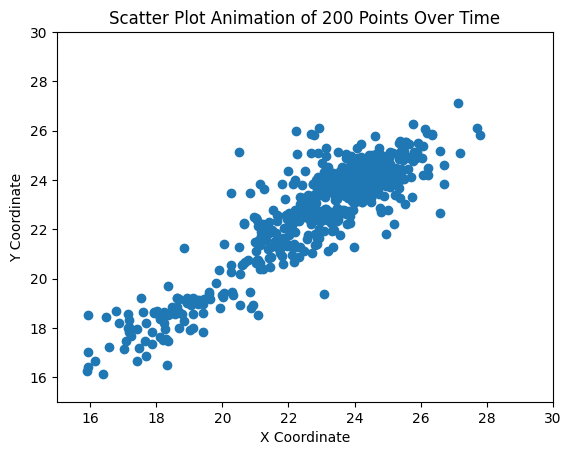

In [95]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# 假设 x 和 y 是你已有的两个变量，维度均为 (5000, 200)
# 在这里我们生成一些随机数据来模拟 x 和 y
x =  np.squeeze( np.array(total_actuals), axis=-1) 
y =  np.squeeze( np.array(total_predictions), axis=-1)  

# 创建图形和坐标轴
fig, ax = plt.subplots()
scat = ax.scatter(x[0], y[0])

# 设置坐标轴的范围，确保所有点都能显示
ax.set_xlim(15, 30)
ax.set_ylim(15, 30)
ax.set_xlabel('X Coordinate')
ax.set_ylabel('Y Coordinate')
ax.set_title('Scatter Plot Animation of 200 Points Over Time')

# 更新函数，用于更新每一帧的数据
def update(frame):
    scat.set_offsets(np.c_[x[frame], y[frame]])
    return scat,

# 创建动画，interval 参数控制每帧之间的间隔时间，单位为毫秒
ani = FuncAnimation(fig, update, frames=range(len(x)), interval=60, blit=False)

# 在 Jupyter Notebook 中显示动画
HTML(ani.to_jshtml())


In [87]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch.amp import GradScaler, autocast
from tqdm import tqdm
from sklearn.metrics import r2_score

# `torch.cuda.amp.GradScaler(args...)` is deprecated. 
# Please use `torch.amp.GradScaler('cuda', args...)` instead.


# 假设模型和数据加载器已经定义好
model=MultimodalMoleculeNet().to(device)
# train_dataloader = ...
# test_dataloader = ...
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

criterion = nn.MSELoss()
criterion2 = nn.L1Loss()

LR = 0.01
# optimizer = optim.AdamW(model.parameters(), lr=LR, weight_decay=1e-5)  # 改为 AdamW 优化器
# scheduler = CosineAnnealingLR(optimizer, T_max=500)  # 使用 CosineAnnealingLR 学习率调度器

optimizer = optim.Adam(model.parameters(), lr=LR, weight_decay=1e-5)  # 定义优化器
scheduler = StepLR(optimizer, step_size=10, gamma=0.9)  # 定义学习率调度器


num_epochs = 10000

scaler = GradScaler('cuda') 

lr_list = []  
best_val_loss = float('inf')
early_stopping_patience = 10000
no_improve_count = 0

pbar = tqdm(range(num_epochs))

for epoch in pbar:
    model.train() 
    running_loss = 0.0
    for x3d, x2d, x1d, x0d, targets in train_dataloader:  
        x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
        
        optimizer.zero_grad()

        with autocast('cuda'):  
            outputs = model(x3d, x2d, x1d)
            loss = criterion(outputs, targets)  

        scaler.scale(loss).backward() 
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0) 
        scaler.step(optimizer)
        scaler.update()

        running_loss += loss.item()

    avg_loss = running_loss / len(train_dataloader)
    scheduler.step()
    current_lr = optimizer.state_dict()['param_groups'][0]['lr']
    lr_list.append(current_lr)

    # 验证阶段
    model.eval()
    total_val_loss = 0.0
    preds_list = []
    targets_list = []
    with torch.no_grad():
        for x3d, x2d, x1d, x0d, targets in test_dataloader:
            x3d, x2d, x1d, targets = x3d.to(device), x2d.to(device), x1d.to(device), targets.to(device)
            outputs = model(x3d, x2d, x1d)
            loss = criterion(outputs, targets)
            total_val_loss += loss.item()

            preds_list.append(outputs.cpu().numpy())
            targets_list.append(targets.cpu().numpy())

    avg_val_loss = total_val_loss / len(test_dataloader)

    # R2 评分计算
    preds_array = np.concatenate(preds_list, axis=0)
    targets_array = np.concatenate(targets_list, axis=0)
    r2 = r2_score(targets_array, preds_array)

    # 更新早停机制
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        no_improve_count = 0
        torch.save(model.state_dict(), 'best_model.pth')  # 保存最优模型权重
        # print(f"Model improved, saving to 'best_model.pth'")
    else:
        no_improve_count += 1

    if no_improve_count >= early_stopping_patience:
        print(f"Validation loss hasn't improved in {early_stopping_patience} epochs. Stopping early.")
        break

    # 打印进度条信息
    pbar.set_postfix({
        'Train': f"{avg_loss:.2f}",
        'Test': f"{avg_val_loss:.2f}",
        'R2': f"{r2:.2f}",
        'LR': f"{current_lr*1000:.6f}"
    })

print("Training completed.")


100%|█| 10000/10000 [2:58:20<00:00,  1.07s/it, Train=4.77, Test=2.23, R2=0.66, L

Training completed.


In [51]:
def model_Performance(dataloader):
    model.eval() 
    actuals = []
    predictions = []
    
    with torch.no_grad():
        for x3d,x2d,x1d,x0d, targets  in dataloader:
            x3d,x2d,x1d,x0d, targets = x3d.to(device),x2d.to(device),x1d.to(device),x0d.to(device),targets.to(device)
    
    
            outputs = model(x3d,x2d,x1d)
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())
    
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    
    plt.figure(figsize=(10, 6))
    plt.scatter(actuals, predictions, alpha=0.5)
    plt.plot([actuals.min(), actuals.max()], [actuals.min(), actuals.max()], 'k--', lw=4)  
    plt.xlabel('Actual Values')
    plt.ylabel('Predictions')
    plt.title('Actual vs. Prediction')
    plt.show()
    
    errors = predictions - actuals
    plt.figure(figsize=(10, 6))
    plt.hist(errors, bins=25, edgecolor='k', alpha=0.6)
    plt.xlabel('Prediction Error')
    plt.ylabel('Count')
    plt.title('Prediction Error Distribution')
    plt.show()


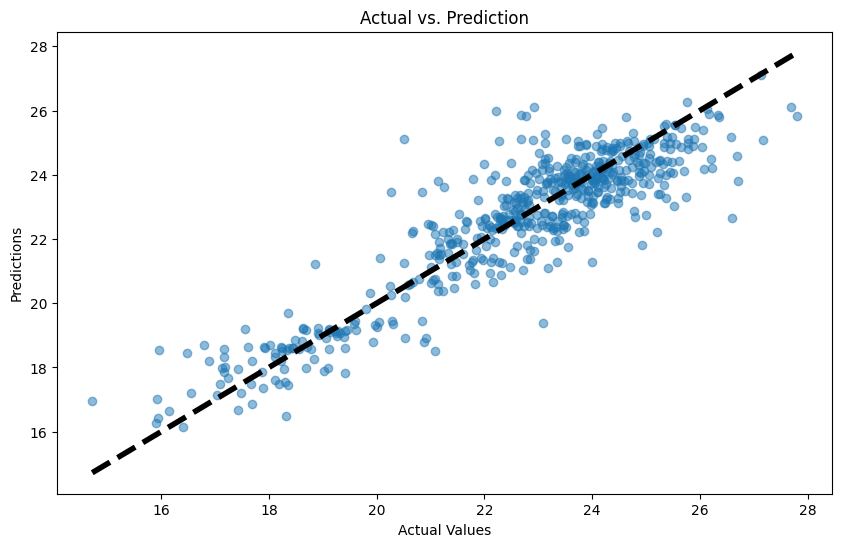

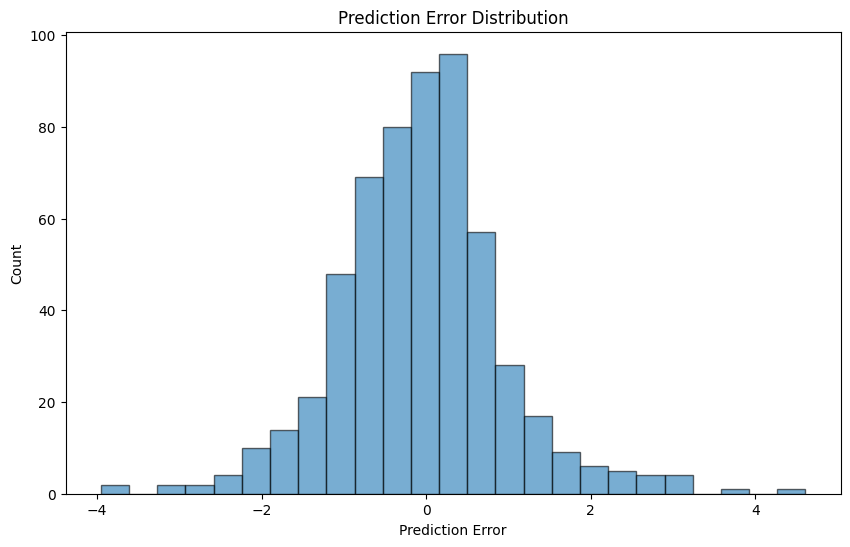

In [96]:
model_Performance(train_dataloader)

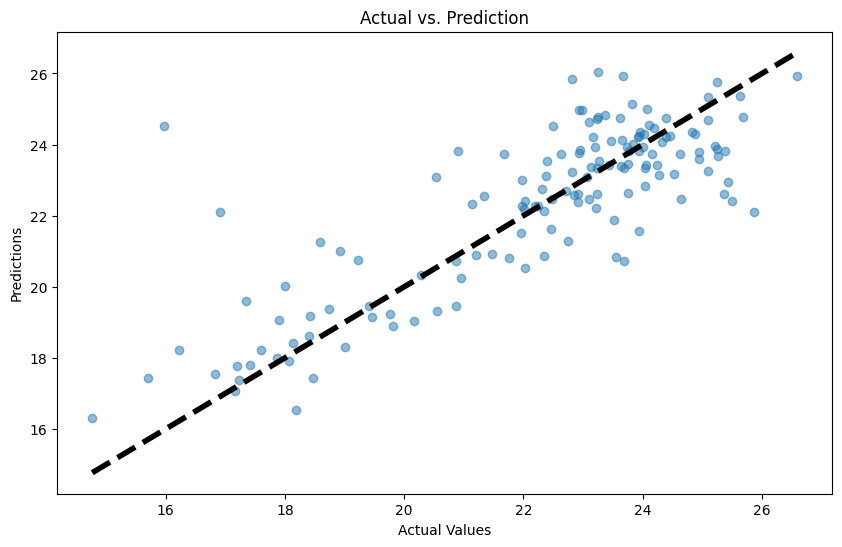

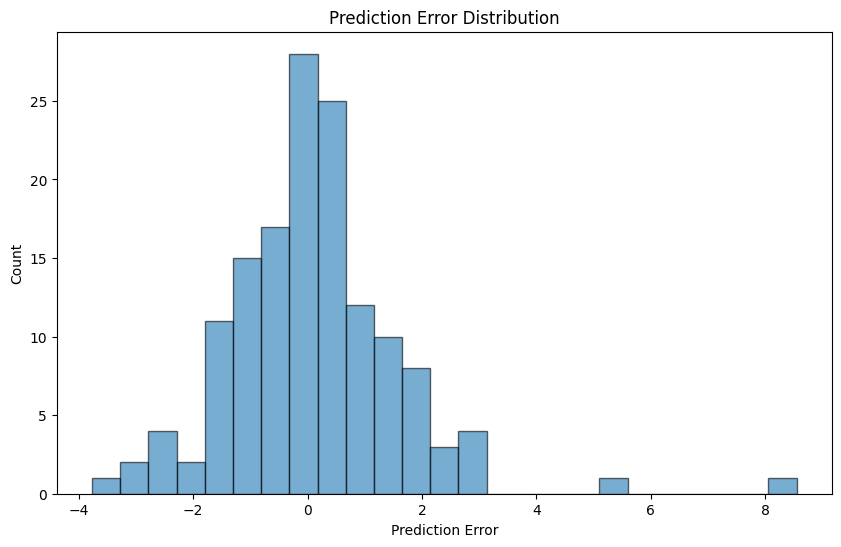

In [97]:
model_Performance(test_dataloader)